# Exercise 11
Georgina Gomes GMSGEO001

# The advection equation
Numerical solution of the 1D advection problem
$$ \frac{\partial T}{\partial t} =  -c \frac{\partial T}{\partial x}$$ 
using an explicit forward in time, centred in space scheme

$T(x,t)$ represents the evolution of temperature distribution along the estuary over time

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

In [3]:
# Parameters of the initial temperature distribution
T0 = 15.        # baseline temperature [degC]
# sigma = width at half amplitude [m]
A = 5.          # amplitude [degC]

## Spatial shape function and grid specification function
The initial shape of the temperature distribution is a Gaussian peak function

In [4]:
# Spatial shape of the temperature disturbance
def Gaussian(x, sigma):
    y = T0+A*np.exp(-(x/sigma)**2)
    return y

The resulting space-time grid depends on the parameters above

In [5]:
# time axis
def setup_grid_axis(xmax, dx, tmax, dt, c):
    NT = int(np.floor(tmax*86400/dt))+1  # number of steps (starts from 0)
    # X axis (centred at 0)
    x = np.arange(-xmax,xmax,dx)
    IM = len(x)             # number of grid points
    T = np.zeros([IM,NT])     # the array holding the numerical solution 
    print('Grid steps : ',IM)
    print('Number of time steps : ',NT)
    print('Timestep = ',dt,' s')
    print('Max numerical speed DX/DT = ',dx/dt,' m/s')
    print('Physical speed = ',c,' m/s')
    print('Courant number = ',c*dt/dx)
    return NT, x, T

## Numerical solution function

In [6]:
def compute_numerical_solution(T0, T, NT, x, dx, dt, c, sigma):
    # Compute the numerical solution using a time loop over the number of time steps
    T[:,0] = Gaussian(x, sigma)    # initial condition
    #prior to starting the loop, the initial values are given from the Gaussian function on one time slice (t=t0=0)
    
    for n in range(NT-1):
        # Question 1
        T[0,n+1]  = T0  #this line sets the value of the first row of the grid in the t=n+1 column to T0 (baseline temperature), this specifies a boundary condition at the edge of the grid
        T[-1,n+1] = T0  #this line sets the value of the last row of the grid in the t=n+1 to T0 (baseline temperature), this also specifies a boundary condition at the edge of the grid
        # Question 2 and Question 3
        rhs = -c*(T[2:,n]-T[:-2,n])/(2.*dx) # L1 this line is working out d_theta by dx. This is the right hand side of the equation. This is the space derivative and it is worked out using the explicit centered-difference scheme
        T[1:-1,n+1] = T[1:-1,n] + rhs*dt    # L2 This line computes the forward in time solution, it is the combination of the two sides of the equation, rearranged to solve for the forward in time value at t=n+1; x=i,this line is working out d_theta by dt. This is the left hand side of the equation. This is the time derivative and its worked out using the explicit euler forward method for time integration.
        #using the explicit scheme means if we have the known quantites at time step n, then we can compute the solution at n+1, ie, down the estuary.
    
        #the final line is giving us the forward in time solutions for every row apart from the first and last row, at time n+1 and is not computed on all elements of the array T because we have already set the value of those rows to be the baseline temperature value, since heat is conserved in this system- we are seeing the temperature preturbation as a blob of oil making a wave throughout the system, which is not necessarily realistic but works well for the model
    return T

## Question 1
- T[0,n+1]  = T0

This line sets the value of the first row of the grid in the t=n+1 column to T0 (baseline temperature), this specifies a boundary condition at the edge of the grid

- T[-1,n+1] = T0 

This line sets the value of the last row of the grid in the t=n+1 to T0 (baseline temperature), this also specifies a boundary condition at the edge of the grid

## Question 2 Which component of the numerical scheme is implemented in line #L1? What does line #L2 do?

### - L1: This line calculates the discrete form of $-c\frac{\partial T}{\partial x}$ where $\frac{\partial T}{\partial x} \approx \frac{{T_{i+1}}^n - {T_{i-1}}^n}{2\Delta x}$

- This is the space derivative and it is worked out using the explicit centered-difference scheme.
- The notation T[2:,n]-T[:-2,n] represents the subtraction of $T(x + \Delta x, n) - T(x - \Delta x, n)$ and will return an array of this result.

### - L2: This line computes the forward in time value, ${T_i}^{n+1}$, using the discrete FTCS scheme where ${T_i}^{n+1} = {T_i}^n - c\frac{{T_{i+1}}^n - {T_{i-1}}^n}{2\Delta x}\Delta t$ at t=n+1; x=i.
- Using the explicit scheme means if we have the known quantites at time step n, then we can compute the solution at n+1, i.e, down the estuary.
    
- the notation T[1:-1,n+1] is storing the forward in time solution for every row apart from the first and last row, at time n+1 and is not computed on all elements of the array T because we have already set the value of those rows to be the baseline temperature value, since heat is conserved in this system- we are imagining the temperature preturbation as a blob of oil making a wave throughout the system, which is not necessarily realistic but works well for the model

## Matplotlib animation function
The animation below displays the evolution of the solution and compares it with the analytical solution

In [7]:
def plot_1D_advection_animation_comparison(xmax, T0, dt, t0, c, Gaussian, sigma):
    
    NT, x, T = setup_grid_axis(xmax, dx, tmax, dt, c)

    T = compute_numerical_solution(T0, T, NT, x, dx, dt, c, sigma)
    
    fig, ax = plt.subplots()
    # set the axis limits
    plt.axis([-xmax/1000, xmax/1000, T0-3, T0+7])
    # first plot the initial conditions and set the line attributes
    line, = ax.plot(x/1000., Gaussian(x, sigma),'k',label='analytical')
    sol, = ax.plot(x/1000., T[:,0],'m',label='numerical')
    ax.set_xlabel('X (km)')
    ax.set_ylabel('T ($^o$C)')
    plt.legend(loc='upper left')
    
    def animate(i):
        t = t0 + i*dt
        line.set_ydata(Gaussian(x-c*t, sigma))  # update the analytical solution
        sol.set_ydata(T[:,i])  # update the numerical solution
        return line,sol,
    
    # create the animation and loop (interval is in ms)
    ani = animation.FuncAnimation(
        fig, animate, interval=dt, blit=True, frames=NT, repeat=True)
    
    # To save the animation, use e.g.
    # ani.save("movie.mp4")
    # or
    # writer = animation.FFMpegWriter(
    #     fps=15, metadata=dict(artist='Me'), bitrate=1800)
    # ani.save("movie.mp4", writer=writer)
    
    # display the animation as a javascript object embedded in the notebook
    from IPython.display import HTML
    return HTML(ani.to_jshtml())

# Original case where Courant number is 0.5:

Grid steps :  100
Number of time steps :  44
Timestep =  200  s
Max numerical speed DX/DT =  1.0  m/s
Physical speed =  0.5  m/s
Courant number =  0.5


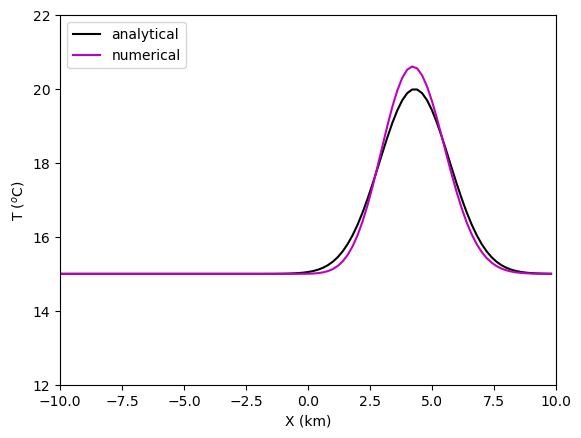

In [8]:
c=0.5       # Advection speed [m s-1]
dx=200      # X resolution [m]
dt=200      # time step [s]
t0=0.       # initial time
tmax=0.1    # duration of simulation [days]
xmax=10.0e3 # length of the basin [m]

plot_1D_advection_animation_comparison(xmax, T0, dt, t0, c, Gaussian, 2000)

The numerical solution expands its perturbation wave height and the slope gets steeper with time, but it is overall very close to the analytical solution. Possible reason for this is due to computing/truncation error??

# Case where Courant number is increased to 1 by halving dx:

Grid steps :  200
Number of time steps :  44
Timestep =  200  s
Max numerical speed DX/DT =  0.5  m/s
Physical speed =  0.5  m/s
Courant number =  1.0


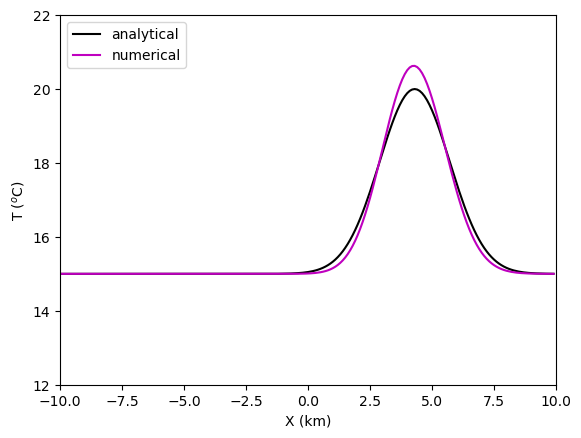

In [11]:
c=0.5       # Advection speed [m s-1]
dx=100      # X resolution [m]
dt=200      # time step [s]
t0=0.       # initial time
tmax=0.1    # duration of simulation [days]
xmax=10.0e3 # length of the basin [m]

plot_1D_advection_animation_comparison(xmax, T0, dt, t0, c, Gaussian, 2000)

This solution doesn't seem to move differently from the case where the courant number is 0.5, so we could not say that our capability to resolve the real gradients is improved here.

# Case where dx=500m and dt=100s to get courant number 0.1:

Grid steps :  40
Number of time steps :  87
Timestep =  100  s
Max numerical speed DX/DT =  5.0  m/s
Physical speed =  0.5  m/s
Courant number =  0.1


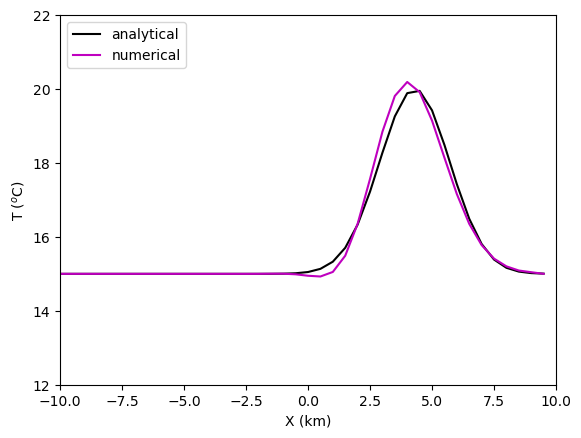

In [12]:
c=0.5       # Advection speed [m s-1]
dx=500      # X resolution [m]
dt=100      # time step [s]
t0=0.       # initial time
tmax=0.1    # duration of simulation [days]
xmax=10.0e3 # length of the basin [m]

plot_1D_advection_animation_comparison(xmax, T0, dt, t0, c, Gaussian, 2000)

In this case, the numerical solution seems to be almost lagging behind the analytical solution. It slightly increases in height over time but not as much as the original case where the courant number is 0.5. The solution seems to match up pretty well, I'd interpret this as pretty stable.

# Steeper wave case where sigma = 1000m:

Grid steps :  100
Number of time steps :  44
Timestep =  200  s
Max numerical speed DX/DT =  1.0  m/s
Physical speed =  0.5  m/s
Courant number =  0.5


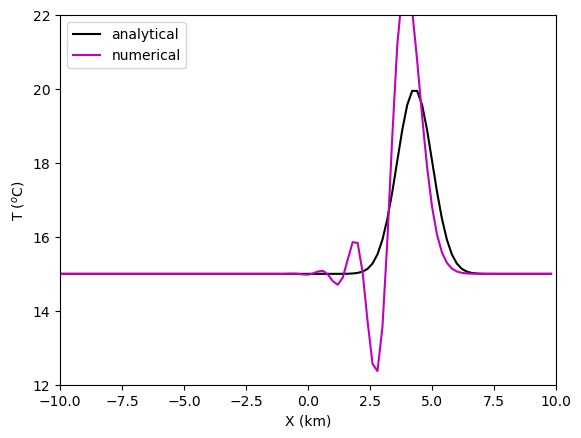

In [13]:
c=0.5       # Advection speed [m s-1]
dx=200      # X resolution [m]
dt=200      # time step [s]
t0=0.       # initial time
tmax=0.1    # duration of simulation [days]
xmax=10.0e3 # length of the basin [m]

plot_1D_advection_animation_comparison(xmax, T0, dt, t0, c, Gaussian, 1000)

# To recover the same degree of accuracy of the previous solution in this case where sigma=1000m you can decrease the timestep and half dx:

Grid steps :  200
Number of time steps :  433
Timestep =  20  s
Max numerical speed DX/DT =  5.0  m/s
Physical speed =  0.5  m/s
Courant number =  0.1


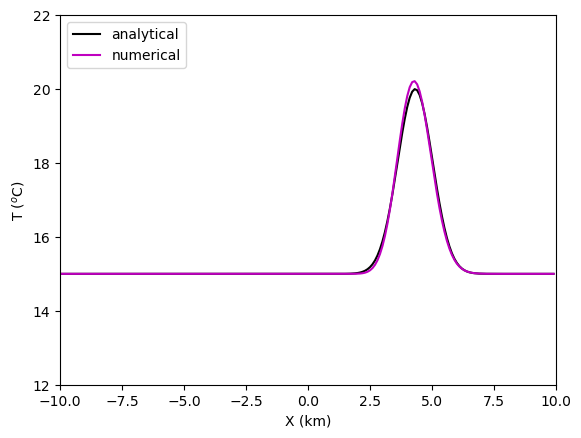

In [14]:
c=0.5       # Advection speed [m s-1]
dx=100      # X resolution [m]
dt=20      # time step [s]
t0=0.       # initial time
tmax=0.1    # duration of simulation [days]
xmax=10.0e3 # length of the basin [m]

plot_1D_advection_animation_comparison(xmax, T0, dt, t0, c, Gaussian, 1000)

# What happens after you double the speed of the current?
The solution seems to become inaccurate/unstable very fast, the courant number becomes 1.0. (this is shown on other duplicated notebook)